In [1]:
# Support for maths
import numpy as np
# Plotting tools
from matplotlib import pyplot as plt
# we use the following for plotting figures in jupyter
%matplotlib inline
# Importing data library
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

# GPy: Gaussian processess libary
import GPy
from IPython.display import display

import datetime

plt.rcParams.update({'font.size': 32})

In [3]:
# Pembacaan File Data Polusi Udara ISPU Excel
DKI2 = pd.read_excel("./Data/Normalization/DATA ISPU - Normalization.xlsx", sheet_name="DKI2")

### PM10

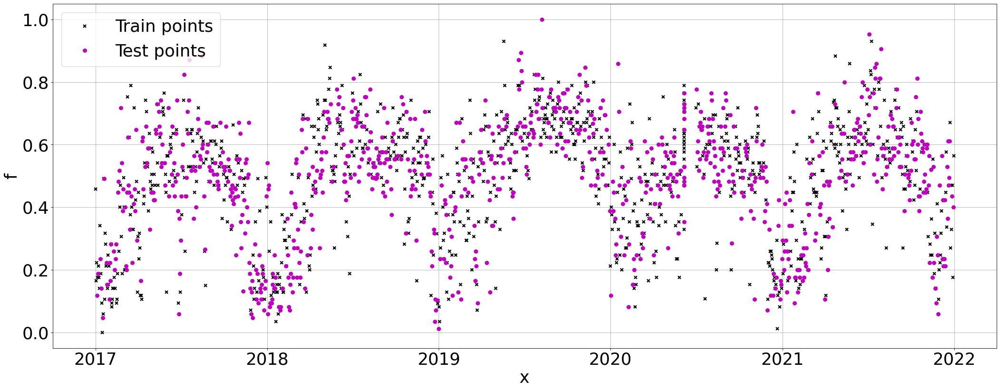

In [4]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI2.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI2['PM10']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.5, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI2['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI2['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [5]:
k1 = GPy.kern.StdPeriodic(1, period=2)
m1 = GPy.models.GPRegression(train_X, train_Y, k1)
m1.optimize(messages=1, ipython_notebook=True)

In [6]:
m1

GP_regression.,value,constraints,priors
std_periodic.variance,1.169480251853555,+ve,
std_periodic.period,1.9972497018274062,+ve,
std_periodic.lengthscale,0.45301698968876175,+ve,
Gaussian_noise.variance,0.0239487562902924,+ve,


In [7]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m1.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [8]:
from sklearn import metrics

def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    mape = metrics.mean_absolute_percentage_error(true,predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('MAPE:', mape)

    print('R2 Square', r2_square)
    print('__________________________________')

In [9]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m1.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.12024655123092291
MSE: 0.021982435447365434
RMSE: 0.1482647478241724
MAPE: 0.4645661139918994
R2 Square 0.3720514101716691
__________________________________


In [10]:
metrics.r2_score(train_Y.flatten(), m1.predict(train_X)[0].flatten())

0.3357796233810211

In [11]:
# Pengambilan Data Forecasting
PM10_Index = np.arange(1826, 1857, dtype=np.int64)
PM10_Index = np.reshape(PM10_Index, (-1, 1))
PM10_Forecasting = m1.predict(PM10_Index)[0].flatten()

In [12]:
# Denormalisasi
max = 98.0
min = 13.0
PM10_Forecasting_denorm = (PM10_Forecasting.flatten() * (max - min) + min)
# PM10_Forecasting_denorm

### SO2

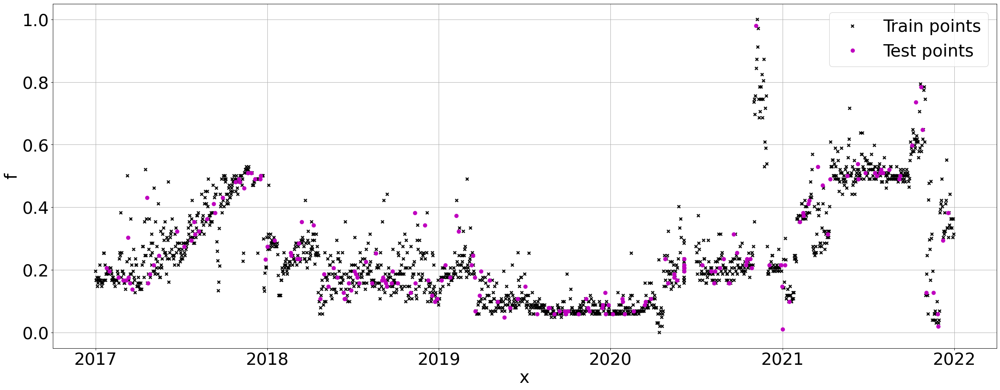

In [13]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI2.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI2['SO2']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.1, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI2['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI2['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [14]:
k2 = GPy.kern.StdPeriodic(1, period=2)
m2 = GPy.models.GPRegression(train_X, train_Y, k2)
m2.optimize(messages=1, ipython_notebook=True)

In [15]:
m2

GP_regression.,value,constraints,priors
std_periodic.variance,0.059586784014683813,+ve,
std_periodic.period,1.9989100475358847,+ve,
std_periodic.lengthscale,0.017750072371827734,+ve,
Gaussian_noise.variance,0.003610150930165592,+ve,


In [16]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m2.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [17]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m2.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.04366617239146332
MSE: 0.00484695503718065
RMSE: 0.06962007639453328
MAPE: 0.36658229361997047
R2 Square 0.8147068769992467
__________________________________


In [18]:
metrics.r2_score(train_Y.flatten(), m2.predict(train_X)[0].flatten())

0.8831302121703188

In [19]:
# Pengambilan Data Forecasting
SO2_Index = np.arange(1826, 1857, dtype=np.int64)
SO2_Index = np.reshape(SO2_Index, (-1, 1))
SO2_Forecasting = m2.predict(SO2_Index)[0].flatten()

In [20]:
# Denormalisasi
max = 103.0
min = 1.0
SO2_Forecasting_denorm = (SO2_Forecasting.flatten() * (max - min) + min)
# SO2_Forecasting_denorm

### CO

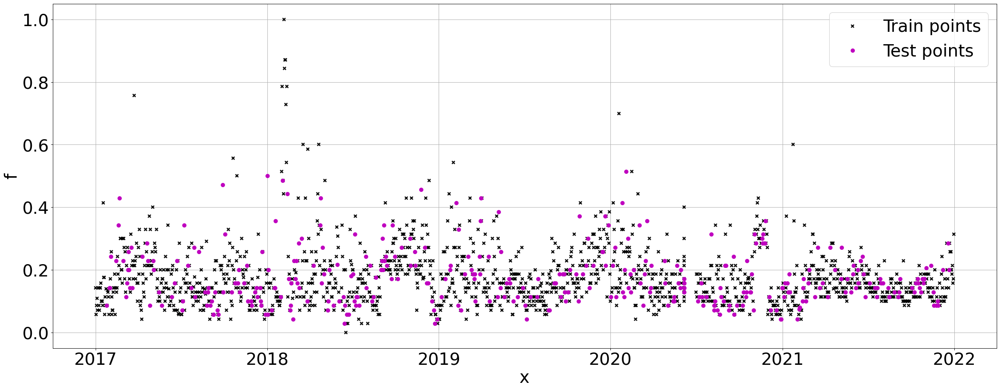

In [21]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI2.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI2['CO']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.2, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI2['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI2['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [22]:
k3 = GPy.kern.StdPeriodic(1, period=2)
m3 = GPy.models.GPRegression(train_X, train_Y, k3)
m3.optimize(messages=1, ipython_notebook=True)

In [23]:
m3

GP_regression.,value,constraints,priors
std_periodic.variance,0.9832258864325402,+ve,
std_periodic.period,1.9946870308699054,+ve,
std_periodic.lengthscale,0.8388207044986877,+ve,
Gaussian_noise.variance,0.009296616299232528,+ve,


In [24]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m3.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [25]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m3.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.06573285223581188
MSE: 0.007410633719864444
RMSE: 0.08608503772354661
MAPE: 0.5130716510341096
R2 Square 0.059435002441440954
__________________________________


In [26]:
metrics.r2_score(train_Y.flatten(), m3.predict(train_X)[0].flatten())

0.05307877109518444

In [27]:
# Pengambilan Data Forecasting
CO_Index = np.arange(1826, 1857, dtype=np.int64)
CO_Index = np.reshape(CO_Index, (-1, 1))
CO_Forecasting = m2.predict(CO_Index)[0].flatten()

In [28]:
# Denormalisasi
max = 71.0
min = 1.0
CO_Forecasting_denorm = (CO_Forecasting.flatten() * (max - min) + min)
# CO_Forecasting_denorm

### O3

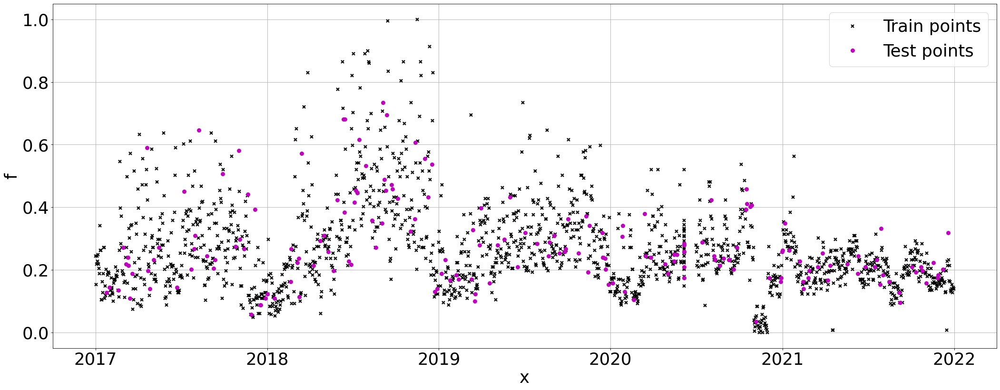

In [29]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI2.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI2['O3']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.1, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI2['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI2['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [30]:
k4 = GPy.kern.StdPeriodic(1, period=2)
m4 = GPy.models.GPRegression(train_X, train_Y, k4)
m4.optimize(messages=1, ipython_notebook=True)

In [31]:
m4

GP_regression.,value,constraints,priors
std_periodic.variance,1.0617155252714343,+ve,
std_periodic.period,1.997170018319398,+ve,
std_periodic.lengthscale,0.5639697251651772,+ve,
Gaussian_noise.variance,0.016982975104759015,+ve,


In [32]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m4.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [33]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m4.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.09292834277505894
MSE: 0.014842808005458282
RMSE: 0.12183106338474717
MAPE: 0.41576360892595604
R2 Square 0.1804602943522592
__________________________________


In [34]:
metrics.r2_score(train_Y.flatten(), m4.predict(train_X)[0].flatten())

0.16034935497793412

In [35]:
# Pengambilan Data Forecasting
O3_Index = np.arange(1826, 1857, dtype=np.int64)
O3_Index = np.reshape(O3_Index, (-1, 1))
O3_Forecasting = m2.predict(O3_Index)[0].flatten()

In [36]:
# Denormalisasi
max = 234.0
min = 5.0
O3_Forecasting_denorm = (O3_Forecasting.flatten() * (max - min) + min)
# O3_Forecasting_denorm

### NO2

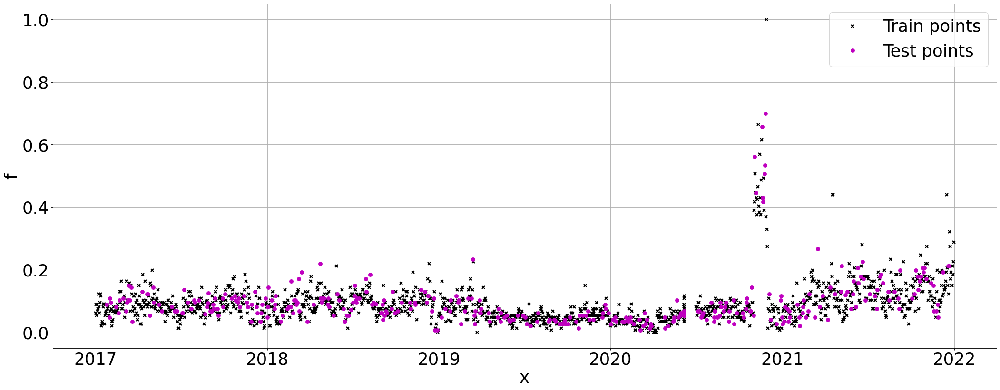

In [37]:
# X = np.array(DKI1.Tanggal.astype('int64') // 10**9)
X = np.array(DKI2.index).reshape(-1,1)
# X = np.array(DKI1['Tanggal']).reshape(-1,1)
Y = np.array(DKI2['NO2']).reshape(-1,1)

from sklearn.model_selection import train_test_split

train_X, test_X, train_Y, test_Y = train_test_split(X, Y, test_size=0.2, random_state=42, shuffle=True)

# Plot observations
plt.figure(figsize=(32, 12), dpi=80)
plt.plot(np.array(DKI2['Tanggal'].loc[train_X.flatten()]).reshape(-1,1), train_Y, "kx", mew=2, label='Train points')
plt.plot(np.array(DKI2['Tanggal'].loc[test_X.flatten()]).reshape(-1,1), test_Y, "mo", mew=2, label='Test points')

# Annotate plot
plt.xlabel("x"), plt.ylabel("f")
plt.grid()
plt.legend()

In [38]:
k5 = GPy.kern.StdPeriodic(1, period=2)
m5 = GPy.models.GPRegression(train_X, train_Y, k5)
m5.optimize(messages=1, ipython_notebook=True)

In [39]:
m5

GP_regression.,value,constraints,priors
std_periodic.variance,1.0249170310341242,+ve,
std_periodic.period,1.9990181837549872,+ve,
std_periodic.lengthscale,0.750021164144148,+ve,
Gaussian_noise.variance,0.0038363022743845322,+ve,


In [40]:
plt.rc('figure', figsize=(64, 24), dpi=240)
m5.plot()
ax = plt.gca()
# ax.plot(train_X, train_Y, color="green", mew=2, label="Train points")
# ax.plot(test_X, test_Y, color="orange", mew=2, label="Test points")
ax.plot(test_X, test_Y, "mo", mew=2, label="Test points")

ax.legend()

In [41]:
print('Evaluation:\n_____________________________________')
print_evaluate(test_Y.flatten(), m5.predict(test_X)[0].flatten())

Evaluation:
_____________________________________
MAE: 0.037099363392307495
MSE: 0.005511750037545296
RMSE: 0.07424116134291876
MAPE: 0.5505159528817758
R2 Square 0.15873622462228054
__________________________________


In [42]:
metrics.r2_score(train_Y.flatten(), m5.predict(train_X)[0].flatten())

0.1836540059903291

In [43]:
# Pengambilan Data Forecasting
NO2_Index = np.arange(1826, 1857, dtype=np.int64)
NO2_Index = np.reshape(NO2_Index, (-1, 1))
NO2_Forecasting = m2.predict(NO2_Index)[0].flatten()

In [44]:
# Denormalisasi
max = 148.0
min = 2.0
NO2_Forecasting_denorm = (NO2_Forecasting.flatten() * (max - min) + min)
# NO2_Forecasting_denorm

### Saving File

In [45]:
start = datetime.datetime.strptime("2022-01-01", "%Y-%m-%d")
date_generated = pd.date_range(start, periods=31)
# print(date_generated.strftime("%Y-%m-%d"))
date_generated

DatetimeIndex(['2022-01-01', '2022-01-02', '2022-01-03', '2022-01-04',
               '2022-01-05', '2022-01-06', '2022-01-07', '2022-01-08',
               '2022-01-09', '2022-01-10', '2022-01-11', '2022-01-12',
               '2022-01-13', '2022-01-14', '2022-01-15', '2022-01-16',
               '2022-01-17', '2022-01-18', '2022-01-19', '2022-01-20',
               '2022-01-21', '2022-01-22', '2022-01-23', '2022-01-24',
               '2022-01-25', '2022-01-26', '2022-01-27', '2022-01-28',
               '2022-01-29', '2022-01-30', '2022-01-31'],
              dtype='datetime64[ns]', freq='D')

In [46]:
d = {"Tanggal":date_generated, "PM10":PM10_Forecasting_denorm, "SO2":SO2_Forecasting_denorm, "CO":CO_Forecasting_denorm, "O3":O3_Forecasting_denorm, "NO2":NO2_Forecasting_denorm}
DKI2_Forecasting = pd.DataFrame(d)
DKI2_Forecasting

,Tanggal,PM10,SO2,CO,O3,NO2
0,2022-01-01,42.889486,28.781162,20.065503,67.371432,41.765193
1,2022-01-02,45.550097,27.925506,19.478289,65.450401,40.540430
2,2022-01-03,42.753625,26.495100,18.496637,62.238998,38.492986
3,2022-01-04,45.370757,25.396928,17.742990,59.773496,36.921093
4,2022-01-05,42.632557,24.454517,17.096237,57.657689,35.572151
5,2022-01-06,45.202504,23.142429,16.195784,54.711923,33.694064
6,2022-01-07,42.526439,22.710996,15.899703,53.743315,33.076524
7,2022-01-08,45.045552,21.246203,14.894453,50.454712,30.979860
8,2022-01-09,42.435407,21.292379,14.926142,50.558380,31.045954
9,2022-01-10,44.900101,19.761017,13.875208,47.120322,28.854005


In [47]:
# Penyimpanan Data Forecasting
DKI2_Forecasting.to_excel('./Data/Forecasting/DKI2_Forecasting.xlsx', index=False)